**Google Drive Bağlantısı**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [1]:
!nvidia-smi

Sun Nov 12 22:20:04 2023       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 546.01                 Driver Version: 546.01       CUDA Version: 12.3     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                     TCC/WDDM  | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce RTX 3050 ...  WDDM  | 00000000:01:00.0 Off |                  N/A |
| N/A   49C    P0               9W /  60W |      0MiB /  4096MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

**Dosyaları Zipten Çıkarma**

In [ ]:
!cd /content
!unzip /content/drive/MyDrive/mmdetection_seg.zip 

Archive:  /content/drive/MyDrive/mmdetection_seg.zip
   creating: mmdetection_seg/
   creating: mmdetection_seg/test/
  inflating: mmdetection_seg/test/1.jpg  
  inflating: mmdetection_seg/test/100.jpg  
  inflating: mmdetection_seg/test/101.jpg  
  inflating: mmdetection_seg/test/102.jpg  
  inflating: mmdetection_seg/test/103.jpg  
  inflating: mmdetection_seg/test/191.jpg  
  inflating: mmdetection_seg/test/192.jpg  
  inflating: mmdetection_seg/test/193.jpg  
  inflating: mmdetection_seg/test/194.jpg  
  inflating: mmdetection_seg/test/195.jpg  
  inflating: mmdetection_seg/test/196.jpg  
  inflating: mmdetection_seg/test/197.jpg  
  inflating: mmdetection_seg/test/198.jpg  
  inflating: mmdetection_seg/test/199.jpg  
  inflating: mmdetection_seg/test/2.jpg  
  inflating: mmdetection_seg/test/200.jpg  
  inflating: mmdetection_seg/test/3.jpg  
  inflating: mmdetection_seg/test/4.jpg  
  inflating: mmdetection_seg/test/5.jpg  
  inflating: mmdetection_seg/test/96.jpg  
  inflating: 

**Kurulumlar**

In [ ]:
!pip install torch==1.9.0+cu111 torchvision==0.10.0+cu111 -f https://download.pytorch.org/whl/torch_stable.html

!pip install mmcv-full -f https://download.openmmlab.com/mmcv/dist/cu111/torch1.9.0/index.html

!rm -rf mmdetection
!git clone https://github.com/open-mmlab/mmdetection.git
%cd mmdetection
!pip install -e .

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in links: https://download.pytorch.org/whl/torch_stable.html
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 2.0/2.0 GB 102.4 MB/s eta 0:00:01tcmalloc: large alloc 2041339904 bytes == 0x2562000 @  0x7f1f7011e1e7 0x4d30a0 0x4d312c 0x5d6f4c 0x51edd1 0x51ef5b 0x4f750a 0x4997a2 0x55cd91 0x5d8941 0x4997a2 0x55cd91 0x5d8941 0x4997a2 0x55cd91 0x5d8941 0x4997a2 0x55cd91 0x5d8941 0x4997a2 0x55cd91 0x5d8941 0x4997a2 0x5d8868 0x4997a2 0x55cd91 0x5d8941 0x49abe4 0x55cd91 0x5d8941 0x4997a2
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╸ 2.0/2.0 GB 108.9 MB/s eta 0:00:01tcmalloc: large alloc 2551676928 bytes == 0x7c028000 @  0x7f1f7011f615 0x5d6f4c 0x51edd1 0x51ef5b 0x4f750a 0x4997a2 0x55cd91 0x5d8941 0x4997a2 0x55cd91 0x5d8941 0x4997a2 0x55cd91 0x5d8941 0x4997a2 0x55cd91 0x5d8941 0x4997a2 0x55cd91 0x5d8941 0x4997a2 0x5d8868 0x4997a2 0x55cd91 0x5d8941 0x49abe4 0x55cd91 0x5d8941 0x4997a2 0x55cd91 0x

**Kütüphaneleri Dahil Etme**

In [ ]:
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())

import mmdet
print(mmdet.__version__)
from mmcv.ops import get_compiling_cuda_version, get_compiler_version
print(get_compiling_cuda_version())
print(get_compiler_version())
import os.path as osp
import mmcv

1.9.0+cu111 True
2.27.0
11.1
GCC 7.3


/usr/local/lib/python3.8/dist-packages/mmcv/__init__.py:20: UserWarning: On January 1, 2023, MMCV will release v2.0.0, in which it will remove components related to the training process and add a data transformation module. In addition, it will rename the package names mmcv to mmcv-lite and mmcv-full to mmcv. See https://github.com/open-mmlab/mmcv/blob/master/docs/en/compatibility.md for more details.
  warnings.warn(


**Transfer Learning için Ağırlıkları İndirme**

In [ ]:
!mkdir checkpoints
!wget -c https://download.openmmlab.com/mmdetection/v2.0/mask_rcnn/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth \
      -O checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth

--2023-01-07 17:15:52--  https://download.openmmlab.com/mmdetection/v2.0/mask_rcnn/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth
Resolving download.openmmlab.com (download.openmmlab.com)... 8.48.85.214, 8.48.85.212, 8.48.85.211, ...
Connecting to download.openmmlab.com (download.openmmlab.com)|8.48.85.214|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 177867103 (170M) [application/octet-stream]
Saving to: ‘checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth’

checkpoints/mask_rc 100%[===================>] 169.63M  11.1MB/s    in 15s     

2023-01-07 17:16:09 (11.0 MB/s) - ‘checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth’ saved [177867103/177867103]



**Config(Yapılandırma) Dosyasını Oluşturma**

In [ ]:
from mmdet.apis import set_random_seed
from mmcv import Config

cfg = Config.fromfile('/content/mmdetection/config.py')

cfg.model.roi_head.bbox_head.num_classes = 3
cfg.model.roi_head.mask_head.num_classes = 3
cfg.data.samples_per_gpu = 4

cfg.work_dir = './sonuc_exps'

cfg.optimizer.lr = 0.02 / 8
cfg.lr_config.warmup = None
cfg.log_config.interval = 10

cfg.runner.max_epochs = 20

cfg.evaluation.metric = 'mAP'
cfg.evaluation.metric = 'bbox'

cfg.lr_config.policy = 'step'
cfg.lr_config.step = 2

cfg.evaluation.interval = 20

cfg.checkpoint_config.interval = 20

cfg.load_from = '/content/mmdetection/checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth'

cfg.seed = 0
set_random_seed(0, deterministic=False)
cfg.device = 'cuda'
cfg.gpu_ids = range(1)

cfg.log_config.hooks = [
    dict(type='TextLoggerHook'),
    dict(type='TensorboardLoggerHook')]

print(f'Config:\n{cfg.pretty_text}')

Config:
model = dict(
    type='MaskRCNN',
    backbone=dict(
        type='ResNet',
        depth=50,
        num_stages=4,
        out_indices=(0, 1, 2, 3),
        frozen_stages=1,
        norm_cfg=dict(type='BN', requires_grad=False),
        norm_eval=True,
        style='caffe',
        init_cfg=dict(
            type='Pretrained',
            checkpoint='open-mmlab://detectron2/resnet50_caffe')),
    neck=dict(
        type='FPN',
        in_channels=[256, 512, 1024, 2048],
        out_channels=256,
        num_outs=5),
    rpn_head=dict(
        type='RPNHead',
        in_channels=256,
        feat_channels=256,
        anchor_generator=dict(
            type='AnchorGenerator',
            scales=[8],
            ratios=[0.5, 1.0, 2.0],
            strides=[4, 8, 16, 32, 64]),
        bbox_coder=dict(
            type='DeltaXYWHBBoxCoder',
            target_means=[0.0, 0.0, 0.0, 0.0],
            target_stds=[1.0, 1.0, 1.0, 1.0]),
        loss_cls=dict(
            type='Cross

**Eğitim**

In [ ]:
from mmdet.datasets import build_dataset
from mmdet.models import build_detector
from mmdet.apis import train_detector

datasets = [build_dataset(cfg.data.train)]

model = build_detector(cfg.model)

model.CLASSES = datasets[0].CLASSES

mmcv.mkdir_or_exist(osp.abspath(cfg.work_dir))
train_detector(model, datasets, cfg, distributed=False, validate=True)

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


2023-01-07 17:32:04,220 - mmdet - INFO - Automatic scaling of learning rate (LR) has been disabled.
2023-01-07 17:32:04,238 - mmdet - INFO - load checkpoint from local path: /content/mmdetection/checkpoints/mask_rcnn_r50_caffe_fpn_mstrain-poly_3x_coco_bbox_mAP-0.408__segm_mAP-0.37_20200504_163245-42aa3d00.pth
2023-01-07 17:32:04,367 - mmdet - WARNING - The model and loaded state dict do not match exactly

size mismatch for roi_head.bbox_head.fc_cls.weight: copying a param with shape torch.Size([81, 1024]) from checkpoint, the shape in current model is torch.Size([4, 1024]).
size mismatch for roi_head.bbox_head.fc_cls.bias: copying a param with shape torch.Size([81]) from checkpoint, the shape in current model is torch.Size([4]).
size mismatch for roi_head.bbox_head.fc_reg.weight: copying a param with shape torch.Size([320, 1024]) from checkpoint, the shape in current model is torch.Size([12, 1024]).
size mismatch for roi_head.bbox_head.fc_reg.bias: copying a param with shape torch.Size

loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


/usr/local/lib/python3.8/dist-packages/torch/nn/functional.py:718: UserWarning: Named tensors and all their associated APIs are an experimental feature and subject to change. Please do not use them for anything important until they are released as stable. (Triggered internally at  /pytorch/c10/core/TensorImpl.h:1156.)
  return torch.max_pool2d(input, kernel_size, stride, padding, dilation, ceil_mode)
2023-01-07 17:32:13,100 - mmdet - INFO - Epoch [1][10/53]	lr: 2.500e-03, eta: 0:11:12, time: 0.641, data_time: 0.241, memory: 4004, loss_rpn_cls: 0.0062, loss_rpn_bbox: 0.0039, loss_cls: 0.4353, acc: 87.5342, loss_bbox: 0.1565, loss_mask: 0.3992, loss: 1.0011
2023-01-07 17:32:15,040 - mmdet - INFO - Epoch [1][20/53]	lr: 2.500e-03, eta: 0:07:14, time: 0.194, data_time: 0.015, memory: 4004, loss_rpn_cls: 0.0049, loss_rpn_bbox: 0.0024, loss_cls: 0.1312, acc: 96.1230, loss_bbox: 0.1500, loss_mask: 0.1431, loss: 0.4316
2023-01-07 17:32:16,979 - mmdet - INFO - Epoch [1][30/53]	lr: 2.500e-03, eta

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 23/23, 18.3 task/s, elapsed: 1s, ETA:     0s

2023-01-07 17:36:28,979 - mmdet - INFO - Evaluating bbox...
2023-01-07 17:36:29,017 - mmdet - INFO - 
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.831
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.997
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.997
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = -1.000
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.831
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.854
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.854
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.854
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = -1.000
 Avera

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.02s).
Accumulating evaluation results...
DONE (t=0.02s).


2023-01-07 17:36:29,020 - mmdet - INFO - Epoch(val) [20][23]	bbox_mAP: 0.8310, bbox_mAP_50: 0.9970, bbox_mAP_75: 0.9970, bbox_mAP_s: -1.0000, bbox_mAP_m: -1.0000, bbox_mAP_l: 0.8310, bbox_mAP_copypaste: 0.831 0.997 0.997 -1.000 -1.000 0.831


**Test(Eval)**

In [ ]:
!python tools/test.py /content/mmdetection/config.py /content/mmdetection/sonuc_exps/latest.pth \
--options "jsonfile_prefix=./results"  --show-dir ./predict_result --eval bbox --out result.pkl

/usr/local/lib/python3.8/dist-packages/mmcv/__init__.py:20: UserWarning: On January 1, 2023, MMCV will release v2.0.0, in which it will remove components related to the training process and add a data transformation module. In addition, it will rename the package names mmcv to mmcv-lite and mmcv-full to mmcv. See https://github.com/open-mmlab/mmcv/blob/master/docs/en/compatibility.md for more details.
  warnings.warn(
tools/test.py:116: UserWarning: --options is deprecated in favor of --eval-options
  warnings.warn('--options is deprecated in favor of --eval-options')
/content/mmdetection/mmdet/utils/setup_env.py:38: UserWarning: Setting OMP_NUM_THREADS environment variable for each process to be 1 in default, to avoid your system being overloaded, please further tune the variable for optimal performance in your application as needed.
  warnings.warn(
/content/mmdetection/mmdet/utils/setup_env.py:48: UserWarning: Setting MKL_NUM_THREADS environment variable for each process to be 1 in 

**Analiz Sonuçlarını Kaydetme**

In [ ]:
!python tools/analysis_tools/analyze_results.py \
       /content/mmdetection/config.py \
       /content/mmdetection/result.pkl \
       /content/mmdetection/


**CONFUSION MATRIX Oluşturma**

In [ ]:
!python /content/mmdetection/tools/analysis_tools/confusion_matrix.py \
/content/mmdetection/config.py \
result.pkl \
/content/mmdetection


**TensorBoard**

In [ ]:
%load_ext tensorboard
%tensorboard --logdir ./sonuc_exps

**Resim Üzerinden Test**

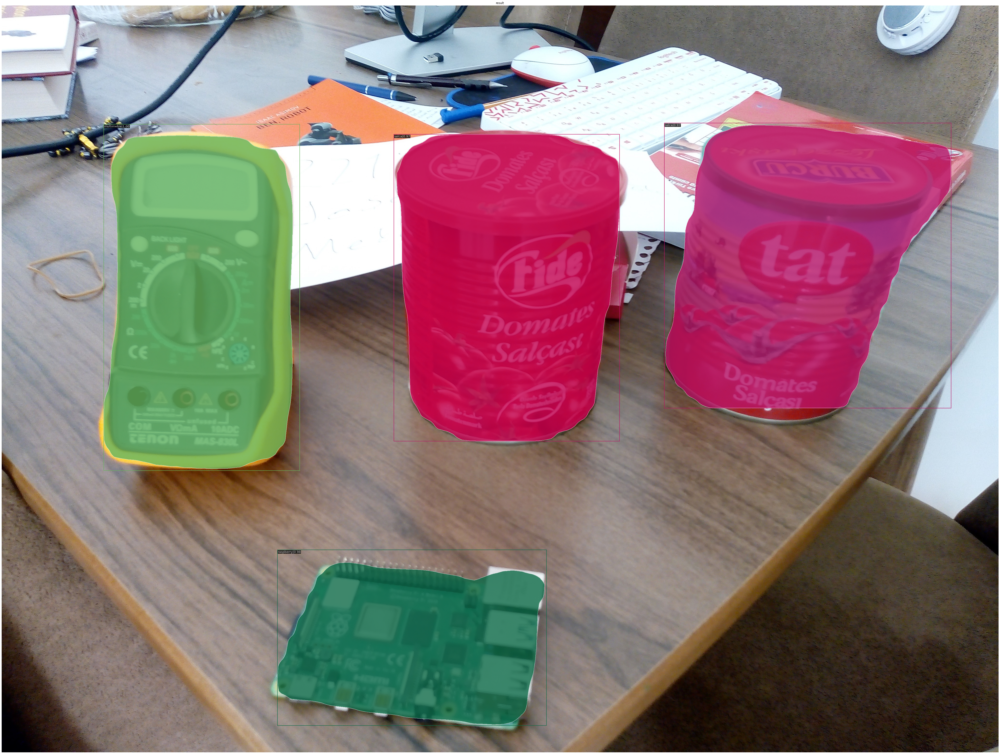

In [ ]:
import mmcv
from mmcv.runner import load_checkpoint

from mmdet.apis import inference_detector, show_result_pyplot
from mmdet.models import build_detector

img = mmcv.imread('/content/drive/MyDrive/v4_data/1.jpg')

model.cfg = cfg
result = inference_detector(model, img)
show_result_pyplot(model, img, result)

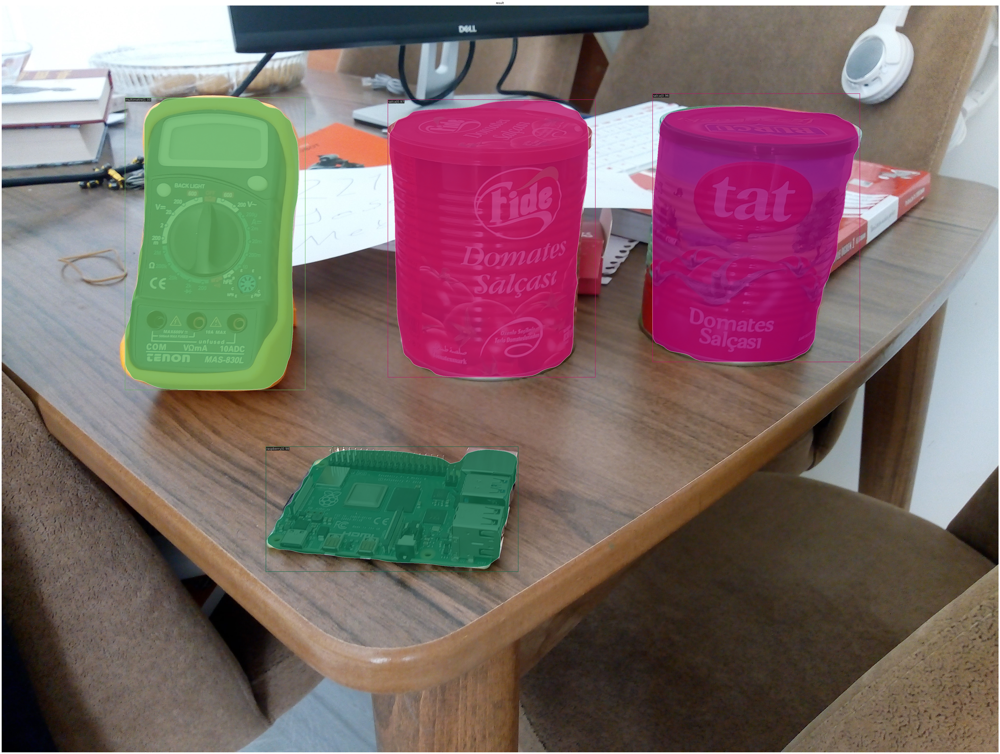

In [ ]:
import mmcv
from mmcv.runner import load_checkpoint

from mmdet.apis import inference_detector, show_result_pyplot
from mmdet.models import build_detector

img = mmcv.imread('/content/drive/MyDrive/v4_data/2.jpg')

model.cfg = cfg
result = inference_detector(model, img)
show_result_pyplot(model, img, result)


**Video Üzerinden Test**

In [ ]:
!python /content/mmdetection/demo/video_demo.py /content/drive/MyDrive/v4_data/video_salca.mp4 --score-thr 0.60 \
/content/mmdetection/config.py \
/content/mmdetection/sonuc_exps/latest.pth \
--out mmdet_video_seg.mp4 